<a href="https://colab.research.google.com/github/Saoudyahya/YOLO-LLM-AUDIO_TO_TEXT/blob/main/YOLO%2BLLM%2BAUDIO_TO_TEXT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ultralytics
!pip install transformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.3/887.3 kB 26.9 MB/s eta 0:00:00


In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json

# Load the YOLOv5 model
model = YOLO("yolov5s.pt")  # Use a lightweight model or replace with larger ones if needed

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    # Construct a simple prompt for the language model based on detected objects
    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = f"Describe an image containing the following objects: {', '.join(object_list)}."

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=50,  # Limit to generating 50 new tokens
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description


def main(image_path):
    # Step 1: Detect objects in the image
    detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate a description based on detected objects
    description = generate_description(detected_objects)
    print("Description:", description)

# Example usage
image_path = "/content/pexels-joshsorenson-139303.jpg"
main(image_path)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 17.7M/17.7M [00:00<00:00, 101MB/s] 
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

WARNING ⚠️ 'source' is missing. Using 'source=/usr/local/lib/python3.10/dist-packages/ultralytics/assets'.

image 1/2 /usr/local/lib/python3.10/dist-packages/ultralytics/assets/bus.jpg: 640x480 4 persons, 1 bus, 817.3ms
image 2/2 /usr/local/lib/python3.10/dist-packages/ultralytics/assets/zidane.jpg: 384x640 2 persons, 2 ties, 555.8ms
Speed: 13.7ms preprocess, 686.5ms inference, 21.0ms postprocess per image at shape (1, 3, 384, 640)


/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:615: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(
The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


Detected Objects: [
  {
    "label": "person",
    "confidence": 0.88,
    "bounding_box": [
      48,
      402,
      245,
      905
    ]
  },
  {
    "label": "bus",
    "confidence": 0.87,
    "bounding_box": [
      2,
      230,
      804,
      739
    ]
  },
  {
    "label": "person",
    "confidence": 0.84,
    "bounding_box": [
      669,
      392,
      809,
      879
    ]
  },
  {
    "label": "person",
    "confidence": 0.84,
    "bounding_box": [
      221,
      406,
      345,
      858
    ]
  },
  {
    "label": "person",
    "confidence": 0.63,
    "bounding_box": [
      0,
      546,
      70,
      871
    ]
  }
]
Description: Describe an image containing the following objects: person with 88.0% confidence, bus with 87.0% confidence, person with 84.0% confidence, person with 84.0% confidence, person with 63.0% confidence.

The following table lists the results of the analysis. The results are based on the data from the previous analysis and are not necessarily 

In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv5 model
model = YOLO("yolov5s.pt")  # 'yolov5s' is a lightweight model

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    # Construct a simple prompt for the language model based on detected objects
    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = f"Describe an image containing the following objects: {', '.join(object_list)}."

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=50,  # Limit to generating 50 new tokens
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def annotate_image(img, detected_objects):
    # Draw bounding boxes on the image
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} ({obj['confidence'] * 100:.0f}%)"

        # Draw the rectangle around each detected object
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Add label text above the rectangle
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return img

def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate a description based on detected objects
    description = generate_description(detected_objects)
    print("Description:", description)

    # Step 3: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 4: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/pexels-joshsorenson-139303.jpg"
main(image_path)


PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


WARNING ⚠️ 'source' is missing. Using 'source=/usr/local/lib/python3.10/dist-packages/ultralytics/assets'.

image 1/2 /usr/local/lib/python3.10/dist-packages/ultralytics/assets/bus.jpg: 640x480 4 persons, 1 bus, 572.6ms
image 2/2 /usr/local/lib/python3.10/dist-packages/ultralytics/assets/zidane.jpg: 384x640 2 persons, 2 ties, 537.0ms
Speed: 4.6ms preprocess, 554.8ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Detected Objects: [
  {
    "label": "person",
    "confidence": 0.88,
    "bounding_box": [
      48,
      402,
      245,
      905
    ]
  },
  {
    "label": "bus",
    "confidence": 0.87,
    "bounding_box": [
      2,
      230,
      804,
      739
    ]
  },
  {
    "label": "person",
    "confidence": 0.84,
    "bounding_box": [
      669,
      392,
      809,
      879
    ]
  },
  {
    "label": "person",
    "confidence": 0.84,
    "bounding_box": [
      221,
      406,
      345,
      858
    ]
  },
  {
    "label": "person",
    "confidence": 0.63,
    "bounding_box": [
      0,
      546,
      70,
      871
    ]
  }
]
Description: Describe an image containing the following objects: person with 88.0% confidence, bus with 87.0% confidence, person with 84.0% confidence, person with 84.0% confidence, person with 63.0% confidence.

The following table lists the results of the analysis. The results are based on the data from the previous analysis and are not necessarily 

AttributeError: 'NoneType' object has no attribute 'copy'

In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv5 model
model = YOLO("yolov5s.pt")  # 'yolov5s' is a lightweight model

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    # Construct a simple prompt for the language model based on detected objects
    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = f"Describe an image containing the following objects: {', '.join(object_list)}."

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=50,  # Limit to generating 50 new tokens
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def annotate_image(img, detected_objects):
    # Draw bounding boxes on the image
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} ({obj['confidence'] * 100:.0f}%)"

        # Draw the rectangle around each detected object
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Add label text above the rectangle
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return img
def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []

    # Assuming the image has a standard width and height, for example:
    image_width = 640
    image_height = 480

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]

        # Determine the center of the bounding box
        center_x = (x1 + x2) / 2
        center_y = (y1 + y2) / 2

        # Determine direction based on the center position
        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "center"

        if center_y < image_height / 3:
            vertical_position = "above"
        elif center_y > 2 * image_height / 3:
            vertical_position = "below"
        else:
            vertical_position = "middle"

        # Create user guidance based on the direction
        if horizontal_position == "left":
            guidance.append(f"Look to your left. There's a {label} nearby.")
        elif horizontal_position == "right":
            guidance.append(f"Look to your right. You will see a {label}.")
        elif horizontal_position == "center":
            guidance.append(f"There's a {label} directly in front of you.")

        if vertical_position == "above":
            guidance.append(f"There's something above you: a {label}.")
        elif vertical_position == "below":
            guidance.append(f"Watch out! There's a {label} below you.")
        elif vertical_position == "middle":
            guidance.append(f"The {label} is at your eye level.")

    # Join guidance messages into a single string
    prompt = "Here are the directions for you:\n" + "\n".join(guidance)

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=100,  # Allow for a more detailed response
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate user guidance based on detected objects
    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    # Step 3: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 4: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/pexels-joshsorenson-139303.jpg"
main(image_path)


In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

model = YOLO("yolov9c.pt")  # 'yolov5s' is a lightweight model

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    # Construct a simple prompt for the language model based on detected objects
    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = f"Describe an image containing the following objects: {', '.join(object_list)}."

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=50,  # Limit to generating 50 new tokens
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def annotate_image(img, detected_objects):
    # Draw bounding boxes on the image
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} ({obj['confidence'] * 100:.0f}%)"

        # Draw the rectangle around each detected object
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Add label text above the rectangle
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return img

def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []
    object_counter = Counter()  # To count occurrences of each label

    # Assuming the image has a standard width and height, for example:
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]
        object_counter[label] += 1  # Count each detected object

        # Determine the center of the bounding box
        center_x = (x1 + x2) / 2

        # Determine direction based on the center position
        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "front"

        # Add to guidance based on position
        if horizontal_position == "left":
            guidance.append(f"There is a {label} to your left.")
        elif horizontal_position == "right":
            guidance.append(f"There is a {label} to your right.")
        else:  # front
            guidance.append(f"A {label} is directly in front of you.")

    # Create summary statements based on counts
    for label, count in object_counter.items():
        position = "right" if count > 0 else "left"  # Arbitrary position for summary
        if count > 1:
            guidance.append(f"There are {count} {label}s on your {position}.")
        elif count == 1:
            guidance.append(f"There is 1 {label} on your {position}.")

    # Join guidance messages into a single paragraph
    prompt = "Here are your directions:\n" + " ".join(guidance)

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=100,  # Allow for a more detailed response
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate user guidance based on detected objects
    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    # Step 3: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 4: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/1c92d02e571e8c934cd5b57946ee44b3-cc_ft_960.jpg"
main(image_path)

In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv9 model
model = YOLO("yolov9c.pt")  # Make sure you have yolov9 weights

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    # Construct a simple prompt for the language model based on detected objects
    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]

    # Add context about the scene, assuming a generic environment
    prompt = (
        f"Describe an image containing the following objects: {', '.join(object_list)}. "
        "Consider the surroundings and provide a comprehensive description of the environment."
    )

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=100,  # Allow for more detailed response
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def annotate_image(img, detected_objects):
    # Draw bounding boxes on the image
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} ({obj['confidence'] * 100:.0f}%)"

        # Draw the rectangle around each detected object
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Add label text above the rectangle
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return img

def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []
    object_counter = Counter()  # To count occurrences of each label

    # Assuming the image has a standard width and height, for example:
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]
        object_counter[label] += 1  # Count each detected object

        # Determine the center of the bounding box
        center_x = (x1 + x2) / 2

        # Determine direction based on the center position
        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "front"

        # Add to guidance based on position
        if horizontal_position == "left":
            guidance.append(f"There is a {label} to your left.")
        elif horizontal_position == "right":
            guidance.append(f"There is a {label} to your right.")
        else:  # front
            guidance.append(f"A {label} is directly in front of you.")

    # Create summary statements based on counts
    for label, count in object_counter.items():
        position = "right" if count > 0 else "left"  # Arbitrary position for summary
        if count > 1:
            guidance.append(f"There are {count} {label}s on your {position}.")
        elif count == 1:
            guidance.append(f"There is 1 {label} on your {position}.")

    # Join guidance messages into a single paragraph
    prompt = "Here are your directions:\n" + " ".join(guidance)

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=100,  # Allow for a more detailed response
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate a comprehensive description of detected objects
    description = generate_description(detected_objects)
    print("Description:", description)

    # Step 3: Generate user guidance based on detected objects
    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    # Step 4: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 5: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/image.jpg"
main(image_path)


In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv9 model
model = YOLO("yolov9c.pt")  # Ensure you have yolov9 weights

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token  # Set padding token to eos token
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = (
        f"Imagine you're in a scene where you can sense the following objects: {', '.join(object_list)}. "
        "Describe these objects vividly, including their colors, sizes, and any sounds they might make. "
        "Also, provide a general sense of the environment around them."
    )

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        attention_mask=inputs.attention_mask,  # Pass the attention mask
        max_new_tokens=150,
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=tokenizer.eos_token_id  # Specify the pad token ID
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description

def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []
    object_counter = Counter()
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]
        object_counter[label] += 1

        center_x = (x1 + x2) / 2

        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "front"

        if horizontal_position == "left":
            guidance.append(f"You have a {label} to your left.")
        elif horizontal_position == "right":
            guidance.append(f"You have a {label} to your right.")
        else:
            guidance.append(f"A {label} is directly in front of you.")

    for label, count in object_counter.items():
        position = "right" if count > 0 else "left"
        if count > 1:
            guidance.append(f"There are {count} {label}s on your {position}.")
        elif count == 1:
            guidance.append(f"There is 1 {label} on your {position}.")

    prompt = "Here are your directions:\n" + " ".join(guidance)

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        attention_mask=inputs.attention_mask,  # Pass the attention mask
        max_new_tokens=100,
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=tokenizer.eos_token_id  # Specify the pad token ID
    )

    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description


def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate a comprehensive description of detected objects
    description = generate_description(detected_objects)
    print("Description for a Blind Person:", description)

    # Step 3: Generate user guidance based on detected objects
    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    # Step 4: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 5: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/image.jpg"
main(image_path)


In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv9 model
model = YOLO("yolov9c.pt")  # Ensure you have yolov9 weights

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token  # Set padding token to eos token
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def generate_description(detected_objects):
    if not detected_objects:
        return "No objects detected in the image."

    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = (
        f"Imagine you're in a scene where you can sense the following objects: {', '.join(object_list)}. "
        "Describe these objects vividly, including their colors, sizes, and any sounds they might make. "
        "Also, provide a general sense of the environment around them."
    )

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        attention_mask=inputs.attention_mask,  # Pass the attention mask
        max_new_tokens=150,
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=tokenizer.eos_token_id  # Specify the pad token ID
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description
def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []
    object_counter = Counter()  # To count occurrences of each label

    # Assuming the image has a standard width and height
    image_width = 640

    # Collecting detected objects and their locations
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]
        object_counter[label] += 1  # Count each detected object

        # Determine the center of the bounding box
        center_x = (x1 + x2) / 2

        # Determine direction based on the center position
        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "front"

        # Add to guidance based on position
        if horizontal_position == "left":
            guidance.append(f"There is a {label} to your left.")
        elif horizontal_position == "right":
            guidance.append(f"There is a {label} to your right.")
        else:  # front
            guidance.append(f"A {label} is directly in front of you.")

    # Create summary statements based on counts
    for label, count in object_counter.items():
        if count > 1:
            guidance.append(f"There are {count} {label}s in the vicinity.")
        elif count == 1:
            guidance.append(f"There is 1 {label} nearby.")

    # Add environmental descriptions
    if "person" in object_counter:
        guidance.append("There are people around you.")
    if "house" in object_counter or "building" in object_counter:
        guidance.append("You are near some houses or buildings.")
    if "tree" in object_counter:
        guidance.append("There are trees nearby.")
    if not object_counter:
        guidance.append("I don't see any familiar objects or landmarks.")

    # Join guidance messages into a single paragraph
    prompt = "describe for a blind person Here are your directions:\n" + " ".join(guidance)

    # Tokenize the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Generate text based on the prompt
    outputs = language_model.generate(
        inputs.input_ids,
        max_new_tokens=100,  # Allow for a more detailed response
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=tokenizer.eos_token_id  # Ensure proper padding
    )

    # Decode and return the description
    description = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return description


def main(image_path):
    # Step 1: Detect objects in the image and get the original image
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    # Step 2: Generate a comprehensive description of detected objects
    description = generate_description(detected_objects)
    print("Description for a Blind Person:", description)

    # Step 3: Generate user guidance based on detected objects
    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    # Step 4: Annotate the image with bounding boxes and labels
    annotated_img = annotate_image(original_img.copy(), detected_objects)

    # Step 5: Display original and annotated images
    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/images.jpg"
main(image_path)



0: 448x640 3 persons, 1 sports ball, 1 bottle, 1 bowl, 2 apples, 3283.2ms
Speed: 11.7ms preprocess, 3283.2ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)
Detected Objects: [
  {
    "label": "person",
    "confidence": 0.94,
    "bounding_box": [
      524,
      284,
      836,
      610
    ]
  },
  {
    "label": "sports ball",
    "confidence": 0.92,
    "bounding_box": [
      1056,
      526,
      1146,
      600
    ]
  },
  {
    "label": "person",
    "confidence": 0.89,
    "bounding_box": [
      265,
      246,
      514,
      609
    ]
  },
  {
    "label": "person",
    "confidence": 0.8,
    "bounding_box": [
      747,
      328,
      1079,
      688
    ]
  },
  {
    "label": "bowl",
    "confidence": 0.79,
    "bounding_box": [
      567,
      572,
      658,
      620
    ]
  },
  {
    "label": "bottle",
    "confidence": 0.58,
    "bounding_box": [
      519,
      526,
      559,
      616
    ]
  },
  {
    "label": "apple",
    "confide

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:638: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


Description for a Blind Person: Imagine you're in a scene where you can sense the following objects: person with 94.0% confidence, sports ball with 92.0% confidence, person with 89.0% confidence, person with 80.0% confidence, bowl with 79.0% confidence, bottle with 57.99999999999999% confidence, apple with 47.0% confidence, apple with 27.0% confidence. Describe these objects vividly, including their colors, sizes, and any sounds they might make. Also, provide a general sense of the environment around them.

The following are some examples of objects that can be used to describe the scene:
. . .
 (1) A person who is in the middle of a conversation. (2) An object that is used as a visual cue to convey a message. The object can also be a reference to a person's name, age, or gender. For example, a picture of an apple can convey the message "I'm in love with this apple."
, an object used for a specific purpose. An example of this can include a description of how the person is feeling, how 

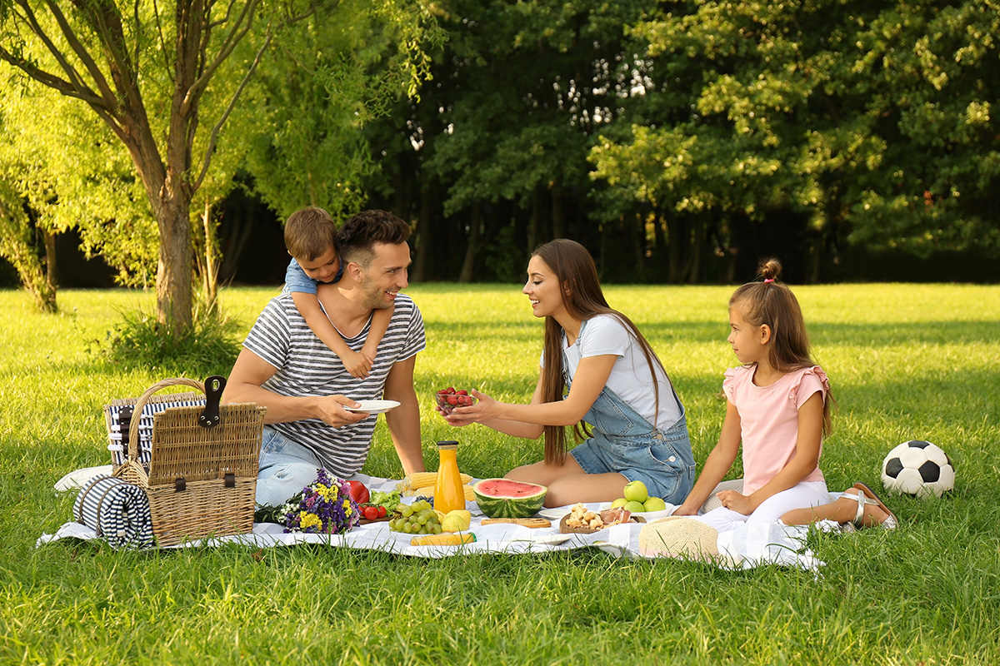

Annotated Image:


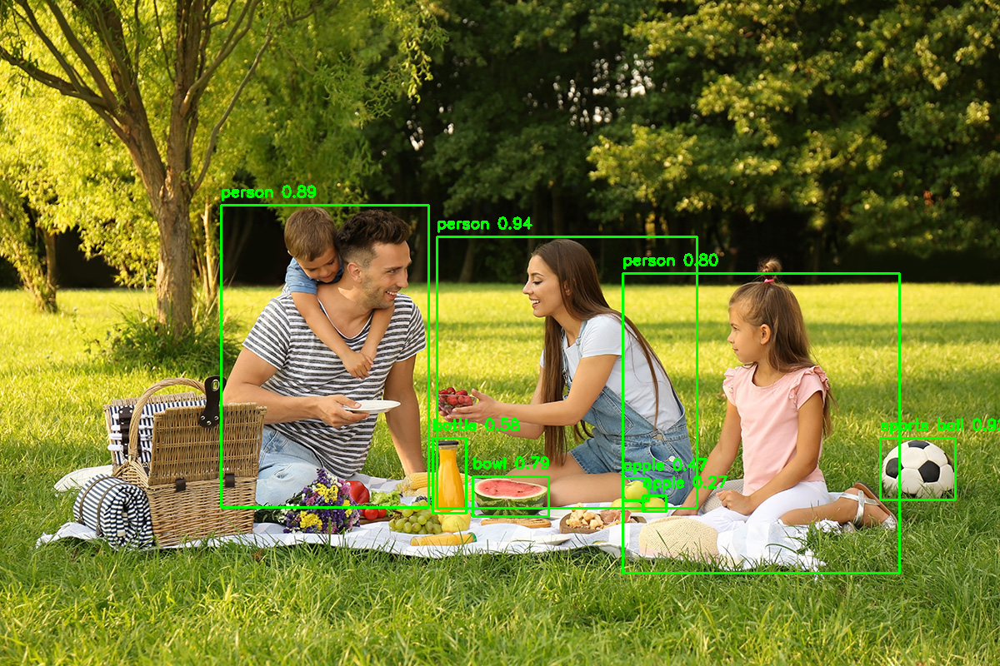

In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Colab

# Load the YOLOv9 model
model = YOLO("yolov9c.pt")  # Ensure you have yolov9 weights

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token  # Set padding token to eos token
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    # Load the image with OpenCV
    img = cv2.imread(image_path)

    # Perform detection with YOLO
    results = model(img)

    # Extract bounding boxes and labels
    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

import numpy as np

# Example reward function that evaluates the description based on its length and the number of detected objects
def reward_function(description, detected_objects):
    # Simple reward based on length and number of detected objects
    reward = 0
    reward += len(description) / 100  # Encourage longer descriptions
    reward += len(detected_objects)  # Encourage more objects described
    return reward

# Modify the generate_description and generate_user_guidance functions to include the reward model
def generate_description(detected_objects, iterations=5):
    if not detected_objects:
        return "No objects detected in the image."

    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = (
        f"Imagine you're in a scene where you can sense the following objects: {', '.join(object_list)}. "
        "Describe these objects vividly, including their colors, sizes, and any sounds they might make. "
        "Also, provide a general sense of the environment around them."
    )

    best_description = ""
    best_reward = -np.inf

    for _ in range(iterations):
        # Tokenize the prompt
        inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)

        # Generate text based on the prompt
        outputs = language_model.generate(
            inputs.input_ids,
            attention_mask=inputs.attention_mask,
            max_new_tokens=150,
            num_return_sequences=1,
            no_repeat_ngram_size=2,
            early_stopping=True,
            pad_token_id=tokenizer.eos_token_id
        )

        # Decode the generated description
        description = tokenizer.decode(outputs[0], skip_special_tokens=True)

        # Calculate the reward for the generated description
        current_reward = reward_function(description, detected_objects)

        # Update the best description if the current one has a higher reward
        if current_reward > best_reward:
            best_reward = current_reward
            best_description = description

    return best_description

def generate_user_guidance(detected_objects, iterations=5):
    if not detected_objects:
        return "I don't see anything in front of you."

    guidance = []
    object_counter = Counter()

    # Assuming the image has a standard width and height
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]
        object_counter[label] += 1

        center_x = (x1 + x2) / 2
        if center_x < image_width / 3:
            horizontal_position = "left"
        elif center_x > 2 * image_width / 3:
            horizontal_position = "right"
        else:
            horizontal_position = "front"

        if horizontal_position == "left":
            guidance.append(f"There is a {label} to your left.")
        elif horizontal_position == "right":
            guidance.append(f"There is a {label} to your right.")
        else:
            guidance.append(f"A {label} is directly in front of you.")

    for label, count in object_counter.items():
        if count > 1:
            guidance.append(f"There are {count} {label}s in the vicinity.")
        elif count == 1:
            guidance.append(f"There is 1 {label} nearby.")

    if "person" in object_counter:
        guidance.append("There are people around you.")
    if "house" in object_counter or "building" in object_counter:
        guidance.append("You are near some houses or buildings.")
    if "tree" in object_counter:
        guidance.append("There are trees nearby.")
    if not object_counter:
        guidance.append("I don't see any familiar objects or landmarks.")

    prompt = "describe for a blind person Here are your directions:\n" + " ".join(guidance)

    best_guidance = ""
    best_reward = -np.inf

    for _ in range(iterations):
        inputs = tokenizer(prompt, return_tensors="pt")
        outputs = language_model.generate(
            inputs.input_ids,
            max_new_tokens=100,
            num_return_sequences=1,
            no_repeat_ngram_size=2,
            early_stopping=True,
            pad_token_id=tokenizer.eos_token_id
        )

        guidance_description = tokenizer.decode(outputs[0], skip_special_tokens=True)

        current_reward = reward_function(guidance_description, detected_objects)

        if current_reward > best_reward:
            best_reward = current_reward
            best_guidance = guidance_description

    return best_guidance

# Update the main function to call the new versions of the description and guidance functions
def main(image_path):
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    description = generate_description(detected_objects)
    print("Description for a Blind Person:", description)

    guidance = generate_user_guidance(detected_objects)
    print("User Guidance:", guidance)

    annotated_img = annotate_image(original_img.copy(), detected_objects)

    print("Original Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/shutterstock_1501433546.jpg"
main(image_path)



0: 448x640 3 persons, 1 sports ball, 1 bottle, 1 bowl, 2 apples, 3504.4ms
Speed: 5.1ms preprocess, 3504.4ms inference, 3.2ms postprocess per image at shape (1, 3, 448, 640)
Detected Objects: [
  {
    "label": "person",
    "confidence": 0.94,
    "bounding_box": [
      524,
      284,
      836,
      610
    ]
  },
  {
    "label": "sports ball",
    "confidence": 0.92,
    "bounding_box": [
      1056,
      526,
      1146,
      600
    ]
  },
  {
    "label": "person",
    "confidence": 0.89,
    "bounding_box": [
      265,
      246,
      514,
      609
    ]
  },
  {
    "label": "person",
    "confidence": 0.8,
    "bounding_box": [
      747,
      328,
      1079,
      688
    ]
  },
  {
    "label": "bowl",
    "confidence": 0.79,
    "bounding_box": [
      567,
      572,
      658,
      620
    ]
  },
  {
    "label": "bottle",
    "confidence": 0.58,
    "bounding_box": [
      519,
      526,
      559,
      616
    ]
  },
  {
    "label": "apple",
    "confiden

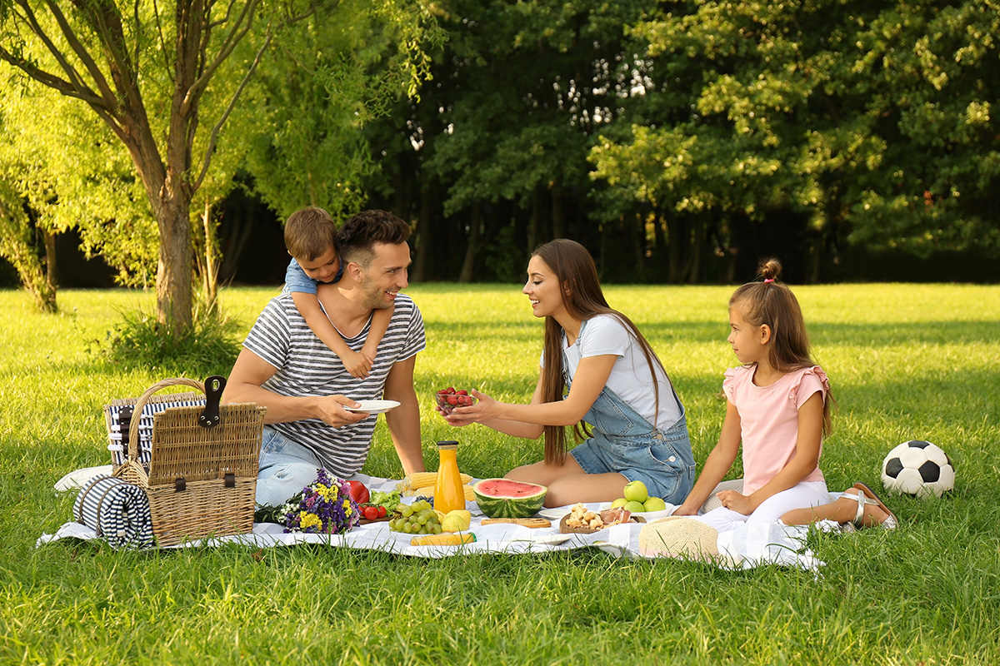

Annotated Image:


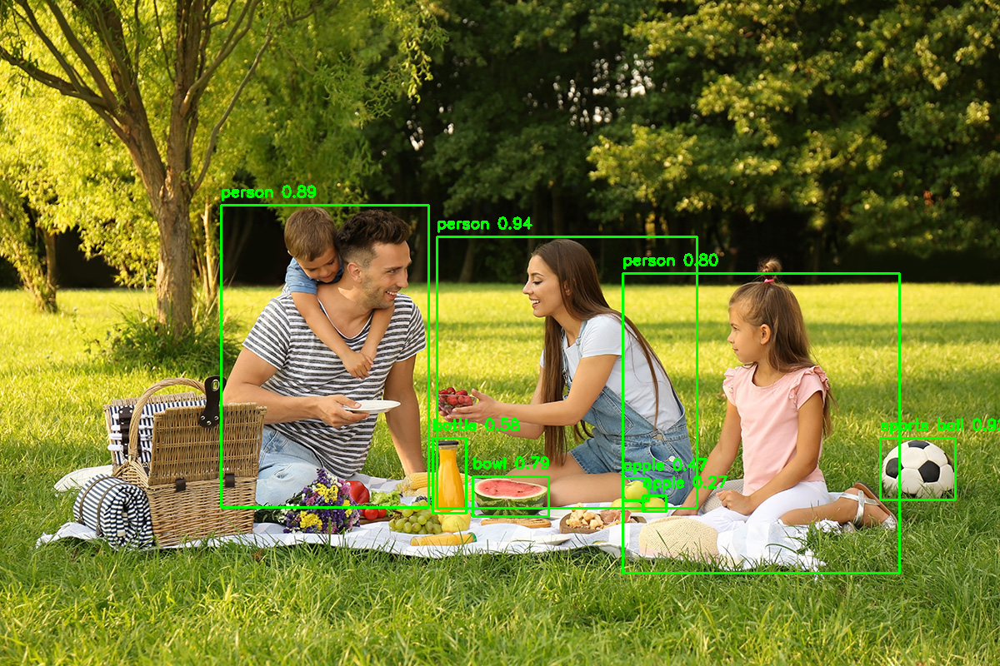

In [ ]:
import torch
from ultralytics import YOLO
from transformers import AutoTokenizer, AutoModelForCausalLM
import cv2
import json
from collections import Counter, defaultdict
from google.colab.patches import cv2_imshow

# Load the YOLOv9 model
model = YOLO("yolov9c.pt")

# Load the Hugging Face language model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("gpt2")
tokenizer.pad_token = tokenizer.eos_token
language_model = AutoModelForCausalLM.from_pretrained("gpt2")

def detect_objects(image_path):
    img = cv2.imread(image_path)
    results = model(img)

    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def annotate_image(img, detected_objects):
    annotated = img.copy()
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} {obj['confidence']:.2f}"
        cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(annotated, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
    return annotated

def reward_function(description, detected_objects):
    reward = 0
    reward += len(description) / 100
    reward += len(detected_objects)
    return reward

def generate_description(detected_objects, iterations=5):
    if not detected_objects:
        return "No objects detected in the image."

    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = (
        f"Imagine you're in a scene where you can sense the following objects: {', '.join(object_list)}. "
        "Describe these objects vividly, including their colors, sizes, and any sounds they might make. "
        "Also, provide a general sense of the environment around them."
    )

    # Generate with num_beams>1 to avoid the warning
    inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)
    outputs = language_model.generate(
        inputs.input_ids,
        attention_mask=inputs.attention_mask,
        max_new_tokens=150,
        num_beams=5,  # Added beam search
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=tokenizer.eos_token_id
    )

    return tokenizer.decode(outputs[0], skip_special_tokens=True)

def generate_user_guidance(detected_objects):
    if not detected_objects:
        return "I don't see anything in front of you."

    # Group objects by position
    position_groups = defaultdict(list)
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]

        center_x = (x1 + x2) / 2
        if center_x < image_width / 3:
            position = "left"
        elif center_x > 2 * image_width / 3:
            position = "right"
        else:
            position = "front"

        position_groups[position].append(label)

    # Generate grouped descriptions
    guidance = []

    # Process each position group
    for position, objects in position_groups.items():
        if objects:
            # Count objects of the same type
            obj_counter = Counter(objects)

            # Create description for this position
            descriptions = []
            for obj, count in obj_counter.items():
                if count > 1:
                    descriptions.append(f"{count} {obj}s")
                else:
                    descriptions.append(f"a {obj}")

            # Join objects with commas and 'and'
            if len(descriptions) > 1:
                objects_text = ", ".join(descriptions[:-1]) + " and " + descriptions[-1]
            else:
                objects_text = descriptions[0]

            guidance.append(f"To your {position}, there is {objects_text}.")

    # Add summary information
    total_counter = Counter([obj["label"] for obj in detected_objects])
    if "person" in total_counter:
        guidance.append(f"In total, there {'is' if total_counter['person'] == 1 else 'are'} "
                       f"{total_counter['person']} {'person' if total_counter['person'] == 1 else 'people'} in the scene.")

    return " ".join(guidance)

def main(image_path):
    original_img, detected_objects = detect_objects(image_path)
    print("Detected Objects:", json.dumps(detected_objects, indent=2))

    description = generate_description(detected_objects)
    print("\nDescription for a Blind Person:", description)

    guidance = generate_user_guidance(detected_objects)
    print("\nUser Guidance:", guidance)

    annotated_img = annotate_image(original_img.copy(), detected_objects)

    print("\nOriginal Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/shutterstock_1501433546.jpg"
main(image_path)

Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "qkv_bias": true,
  "transformers_version": "4.46.2"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_token_id": 50256,
  "embd_pdrop": 0.1,
  "eos_token_id": 50256,
  "initializer_rang


0: 448x640 3 persons, 1 sports ball, 1 bottle, 1 bowl, 2 apples, 1566.0ms
Speed: 5.4ms preprocess, 1566.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Image Caption: two girls and a boy sitting in the grass next to a box 

Detected Objects: [
  {
    "label": "person",
    "confidence": 0.94,
    "bounding_box": [
      524,
      284,
      836,
      610
    ]
  },
  {
    "label": "sports ball",
    "confidence": 0.92,
    "bounding_box": [
      1056,
      526,
      1146,
      600
    ]
  },
  {
    "label": "person",
    "confidence": 0.89,
    "bounding_box": [
      265,
      246,
      514,
      609
    ]
  },
  {
    "label": "person",
    "confidence": 0.8,
    "bounding_box": [
      747,
      328,
      1079,
      688
    ]
  },
  {
    "label": "bowl",
    "confidence": 0.79,
    "bounding_box": [
      567,
      572,
      658,
      620
    ]
  },
  {
    "label": "bottle",
    "confidence": 0.58,
    "bounding_box": [
      519,
      526,

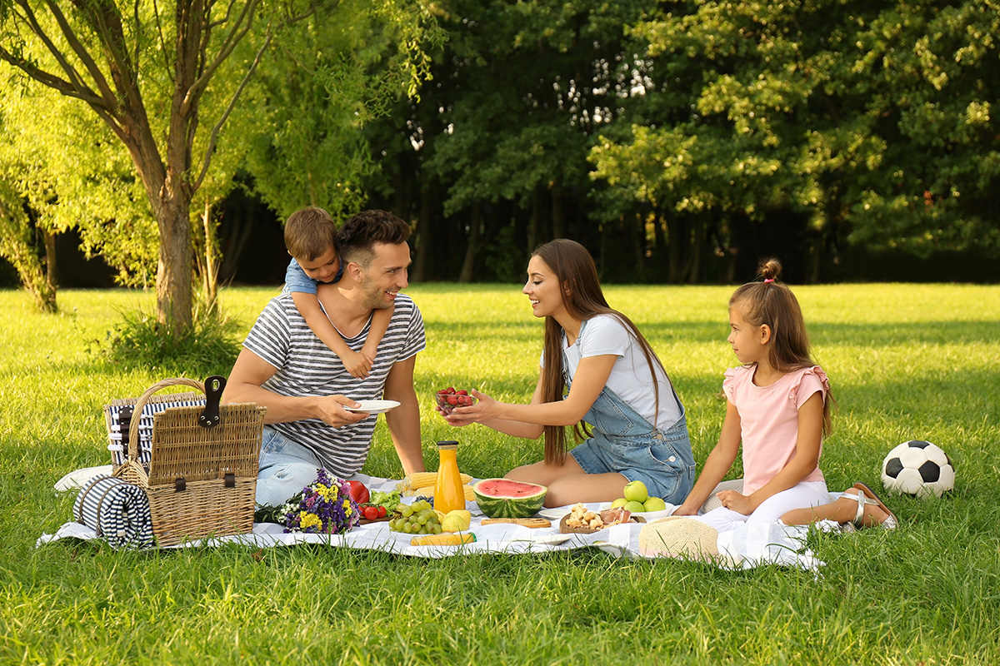

Annotated Image:


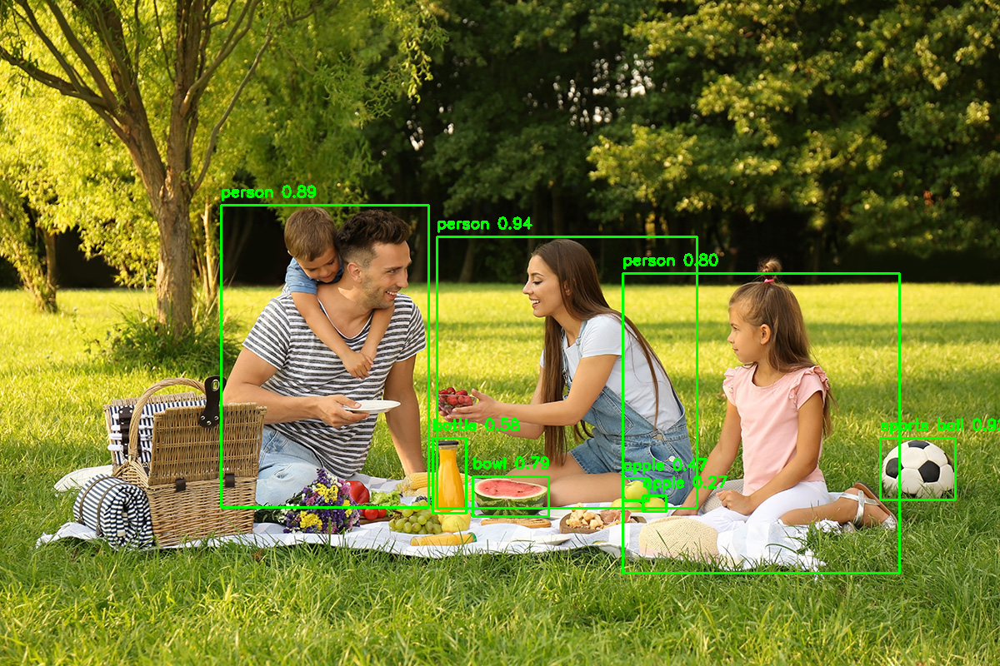

In [ ]:
import torch
from ultralytics import YOLO
from transformers import (
    AutoTokenizer,
    AutoModelForCausalLM,
    VisionEncoderDecoderModel,
    ViTImageProcessor
)
import cv2
import json
from collections import Counter, defaultdict
from google.colab.patches import cv2_imshow
from PIL import Image
import numpy as np

# Load all models
yolo_model = YOLO("yolov9c.pt")
caption_model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
caption_tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
gpt2_tokenizer = AutoTokenizer.from_pretrained("gpt2")
gpt2_model = AutoModelForCausalLM.from_pretrained("gpt2")

# Set padding token
gpt2_tokenizer.pad_token = gpt2_tokenizer.eos_token
caption_tokenizer.pad_token = caption_tokenizer.eos_token

def generate_image_caption(image):
    """Generate a caption for the image using the ViT-GPT2 model"""
    if isinstance(image, np.ndarray):
        # Convert CV2 image (BGR) to PIL Image (RGB)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = Image.fromarray(image)

    pixel_values = image_processor(image, return_tensors="pt").pixel_values

    with torch.no_grad():
        output_ids = caption_model.generate(
            pixel_values,
            max_length=50,
            num_beams=4,
            early_stopping=True
        )

    caption = caption_tokenizer.decode(output_ids[0], skip_special_tokens=True)
    return caption

def detect_objects(image_path):
    img = cv2.imread(image_path)
    results = yolo_model(img)

    detected_objects = []
    for result in results[0].boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = result
        label = yolo_model.names[int(cls)]
        detected_objects.append({
            "label": label,
            "confidence": round(conf, 2),
            "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
        })

    return img, detected_objects

def annotate_image(img, detected_objects):
    annotated = img.copy()
    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = f"{obj['label']} {obj['confidence']:.2f}"
        cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(annotated, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
    return annotated

def reward_function(description, detected_objects):
    reward = 0
    reward += len(description) / 100
    reward += len(detected_objects)
    return reward

def generate_description(detected_objects, caption, iterations=5):
    if not detected_objects:
        return "No objects detected in the image."

    object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
    prompt = (
        f"Image caption: {caption}\n\n"
        f"Detected objects: {', '.join(object_list)}.\n\n"
        "Based on the caption and detected objects, provide a detailed description of the scene, "
        "including the spatial relationships between objects, their approximate locations, "
        "and any relevant context or activities taking place."
    )

    inputs = gpt2_tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)
    outputs = gpt2_model.generate(
        inputs.input_ids,
        attention_mask=inputs.attention_mask,
        max_new_tokens=150,
        num_beams=5,
        num_return_sequences=1,
        no_repeat_ngram_size=2,
        early_stopping=True,
        pad_token_id=gpt2_tokenizer.eos_token_id
    )

    return gpt2_tokenizer.decode(outputs[0], skip_special_tokens=True)

def generate_user_guidance(detected_objects, caption):
    if not detected_objects:
        return "I don't see anything in front of you."

    # Group objects by position
    position_groups = defaultdict(list)
    image_width = 640

    for obj in detected_objects:
        x1, y1, x2, y2 = obj["bounding_box"]
        label = obj["label"]

        center_x = (x1 + x2) / 2
        if center_x < image_width / 3:
            position = "left"
        elif center_x > 2 * image_width / 3:
            position = "right"
        else:
            position = "front"

        position_groups[position].append(label)

    # Start with the general scene description
    guidance = [f"General scene: {caption}"]

    # Process each position group
    for position, objects in position_groups.items():
        if objects:
            obj_counter = Counter(objects)

            descriptions = []
            for obj, count in obj_counter.items():
                if count > 1:
                    descriptions.append(f"{count} {obj}s")
                else:
                    descriptions.append(f"a {obj}")

            if len(descriptions) > 1:
                objects_text = ", ".join(descriptions[:-1]) + " and " + descriptions[-1]
            else:
                objects_text = descriptions[0]

            guidance.append(f"To your {position}, there is {objects_text}.")

    # Add summary information
    total_counter = Counter([obj["label"] for obj in detected_objects])
    if "person" in total_counter:
        guidance.append(f"In total, there {'is' if total_counter['person'] == 1 else 'are'} "
                       f"{total_counter['person']} {'person' if total_counter['person'] == 1 else 'people'} in the scene.")

    return " ".join(guidance)

def main(image_path):
    # Detect objects and generate basic caption
    original_img, detected_objects = detect_objects(image_path)
    image_caption = generate_image_caption(original_img)

    print("Image Caption:", image_caption)
    print("\nDetected Objects:", json.dumps(detected_objects, indent=2))

    description = generate_description(detected_objects, image_caption)
    print("\nDetailed Description:", description)

    guidance = generate_user_guidance(detected_objects, image_caption)
    print("\nUser Guidance:", guidance)

    annotated_img = annotate_image(original_img.copy(), detected_objects)

    print("\nOriginal Image:")
    cv2_imshow(original_img)
    print("Annotated Image:")
    cv2_imshow(annotated_img)

# Example usage
image_path = "/content/shutterstock_1501433546.jpg"
main(image_path)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.4M/49.4M [00:00<00:00, 302MB/s]
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/982M [00:00<?, ?B/s]

Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "qkv_bias": true,
  "transformers_version": "4.46.2"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_token_id": 50256,
  "embd_pdrop": 0.1,
  "eos_token_id": 50256,
  "initializer_rang

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/241 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/120 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]


0: 448x640 3 persons, 1 sports ball, 1 bottle, 1 bowl, 2 apples, 1631.2ms
Speed: 16.8ms preprocess, 1631.2ms inference, 32.2ms postprocess per image at shape (1, 3, 448, 640)


The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-arent-masked.
You may ignore this warning if your `pad_token_id` (50256) is identical to the `bos_token_id` (50256), `eos_token_id` (50256), or the `sep_token_id` (None), and your input is not padded.


Image Caption: two girls and a boy sitting in the grass next to a box 

Detected Objects: [
  {
    "label": "person",
    "confidence": 0.94,
    "bounding_box": [
      524,
      284,
      836,
      610
    ]
  },
  {
    "label": "sports ball",
    "confidence": 0.92,
    "bounding_box": [
      1056,
      526,
      1146,
      600
    ]
  },
  {
    "label": "person",
    "confidence": 0.89,
    "bounding_box": [
      265,
      246,
      514,
      609
    ]
  },
  {
    "label": "person",
    "confidence": 0.8,
    "bounding_box": [
      747,
      328,
      1079,
      688
    ]
  },
  {
    "label": "bowl",
    "confidence": 0.79,
    "bounding_box": [
      567,
      572,
      658,
      620
    ]
  },
  {
    "label": "bottle",
    "confidence": 0.58,
    "bounding_box": [
      519,
      526,
      559,
      616
    ]
  },
  {
    "label": "apple",
    "confidence": 0.47,
    "bounding_box": [
      747,
      574,
      778,
      601
    ]
  },
  {
    "label"

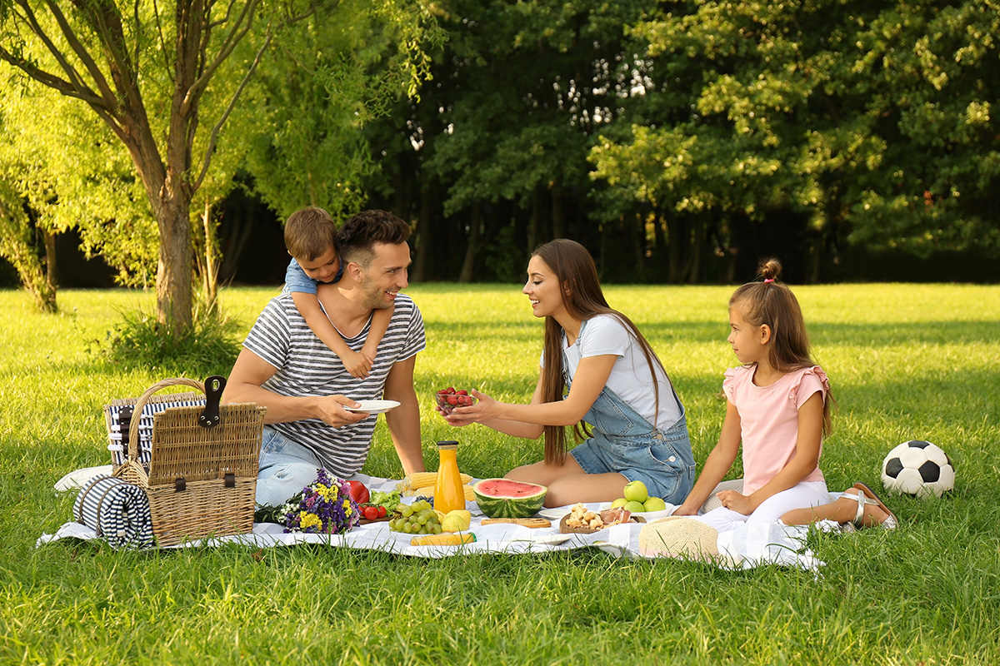

Annotated Image:


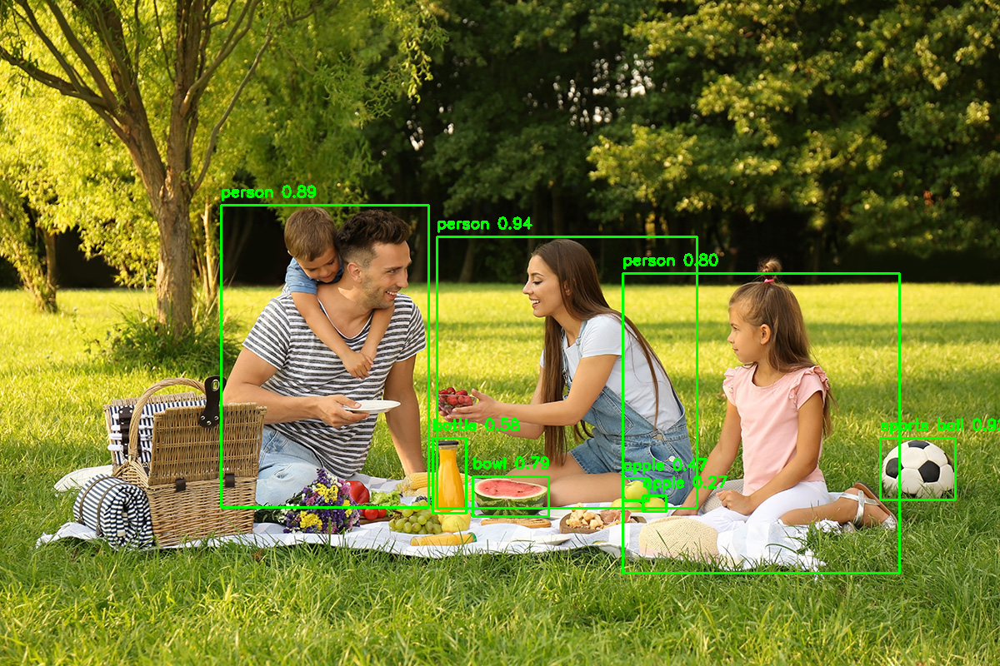

In [ ]:
import torch
from ultralytics import YOLO
from transformers import (
    AutoTokenizer,
    AutoModelForCausalLM,
    VisionEncoderDecoderModel,
    ViTImageProcessor
)
import cv2
import json
from collections import Counter, defaultdict
from google.colab.patches import cv2_imshow
from PIL import Image
import numpy as np

class ObjectDetection:
    def __init__(self, model_path):
        self.model = YOLO(model_path)

    def detect_objects(self, image_path):
        img = cv2.imread(image_path)
        results = self.model(img)
        detected_objects = []
        for result in results[0].boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = result
            label = self.model.names[int(cls)]
            detected_objects.append({
                "label": label,
                "confidence": round(conf, 2),
                "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
            })
        return img, detected_objects

    @staticmethod
    def annotate_image(img, detected_objects):
        annotated = img.copy()
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = f"{obj['label']} {obj['confidence']:.2f}"
            cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        return annotated

class ImageCaptioning:
    def __init__(self, model_name):
        self.model = VisionEncoderDecoderModel.from_pretrained(model_name)
        self.processor = ViTImageProcessor.from_pretrained(model_name)
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_caption(self, image):
        if isinstance(image, np.ndarray):
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = Image.fromarray(image)

        pixel_values = self.processor(image, return_tensors="pt").pixel_values

        with torch.no_grad():
            output_ids = self.model.generate(
                pixel_values,
                max_length=50,
                num_beams=4,
                early_stopping=True
            )

        caption = self.tokenizer.decode(output_ids[0], skip_special_tokens=True)
        return caption

class GPT2DescriptionGenerator:
    def __init__(self, model_name):
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.model = AutoModelForCausalLM.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_description(self, detected_objects, caption):
        if not detected_objects:
            return "No objects detected in the image."

        object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
        prompt = (
            f"Image caption: {caption}\n\n"
            f"Detected objects: {', '.join(object_list)}.\n\n"
            "Based on the caption and detected objects, provide a detailed description of the scene, "
            "including the spatial relationships between objects, their approximate locations, "
            "and any relevant context or activities taking place."
        )

        inputs = self.tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)
        outputs = self.model.generate(
            inputs.input_ids,
            attention_mask=inputs.attention_mask,
            max_new_tokens=150,
            num_beams=5,
            num_return_sequences=1,
            no_repeat_ngram_size=2,
            early_stopping=True,
            pad_token_id=self.tokenizer.eos_token_id
        )

        return self.tokenizer.decode(outputs[0], skip_special_tokens=True)

class UserGuidance:
    @staticmethod
    def generate_guidance(detected_objects, caption, image_width=640):
        if not detected_objects:
            return "I don't see anything in front of you."

        position_groups = defaultdict(list)
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = obj["label"]
            center_x = (x1 + x2) / 2
            if center_x < image_width / 3:
                position = "left"
            elif center_x > 2 * image_width / 3:
                position = "right"
            else:
                position = "front"
            position_groups[position].append(label)

        guidance = [f"General scene: {caption}"]
        for position, objects in position_groups.items():
            if objects:
                obj_counter = Counter(objects)
                descriptions = [f"{count} {obj}s" if count > 1 else f"a {obj}" for obj, count in obj_counter.items()]
                objects_text = ", ".join(descriptions[:-1]) + " and " + descriptions[-1] if len(descriptions) > 1 else descriptions[0]
                guidance.append(f"To your {position}, there is {objects_text}.")

        total_counter = Counter([obj["label"] for obj in detected_objects])
        if "person" in total_counter:
            guidance.append(f"In total, there {'is' if total_counter['person'] == 1 else 'are'} "
                           f"{total_counter['person']} {'person' if total_counter['person'] == 1 else 'people'} in the scene.")
        return " ".join(guidance)

class MainApp:
    def __init__(self, yolo_path, caption_model_name, gpt2_model_name):
        self.detector = ObjectDetection(yolo_path)
        self.captioner = ImageCaptioning(caption_model_name)
        self.description_generator = GPT2DescriptionGenerator(gpt2_model_name)
        self.guidance_generator = UserGuidance()

    def run(self, image_path):
        original_img, detected_objects = self.detector.detect_objects(image_path)
        image_caption = self.captioner.generate_caption(original_img)

        print("Image Caption:", image_caption)
        print("\nDetected Objects:", json.dumps(detected_objects, indent=2))

        description = self.description_generator.generate_description(detected_objects, image_caption)
        print("\nDetailed Description:", description)

        guidance = self.guidance_generator.generate_guidance(detected_objects, image_caption)
        print("\nUser Guidance:", guidance)

        annotated_img = self.detector.annotate_image(original_img.copy(), detected_objects)

        print("\nOriginal Image:")
        cv2_imshow(original_img)
        print("Annotated Image:")
        cv2_imshow(annotated_img)

# Example usage
if __name__ == "__main__":
    yolo_path = "yolov9c.pt"
    caption_model_name = "nlpconnect/vit-gpt2-image-captioning"
    gpt2_model_name = "gpt2"
    image_path = "/content/shutterstock_1501433546.jpg"

    app = MainApp(yolo_path, caption_model_name, gpt2_model_name)
    app.run(image_path)


Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "qkv_bias": true,
  "transformers_version": "4.46.2"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_token_id": 50256,
  "embd_pdrop": 0.1,
  "eos_token_id": 50256,
  "initializer_rang


0: 448x640 3 persons, 1 sports ball, 1 bottle, 1 bowl, 2 apples, 1401.0ms
Speed: 5.2ms preprocess, 1401.0ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Image Caption: two girls and a boy sitting in the grass next to a box 

Detected Objects: [
  {
    "label": "person",
    "confidence": 0.94,
    "bounding_box": [
      524,
      284,
      836,
      610
    ]
  },
  {
    "label": "sports ball",
    "confidence": 0.92,
    "bounding_box": [
      1056,
      526,
      1146,
      600
    ]
  },
  {
    "label": "person",
    "confidence": 0.89,
    "bounding_box": [
      265,
      246,
      514,
      609
    ]
  },
  {
    "label": "person",
    "confidence": 0.8,
    "bounding_box": [
      747,
      328,
      1079,
      688
    ]
  },
  {
    "label": "bowl",
    "confidence": 0.79,
    "bounding_box": [
      567,
      572,
      658,
      620
    ]
  },
  {
    "label": "bottle",
    "confidence": 0.58,
    "bounding_box": [
      519,
      526,

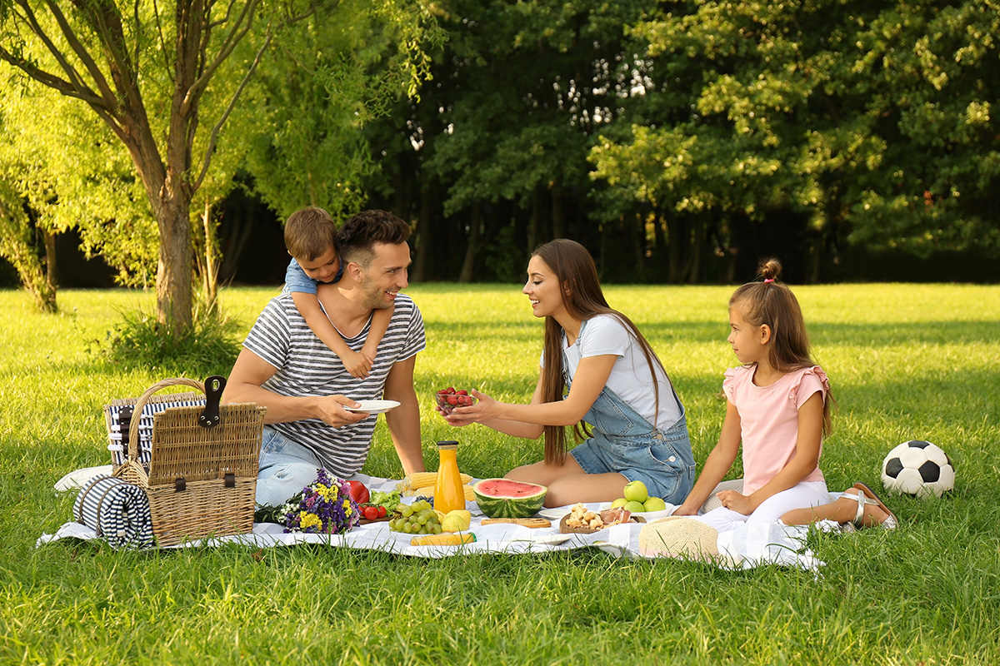

Annotated Image:


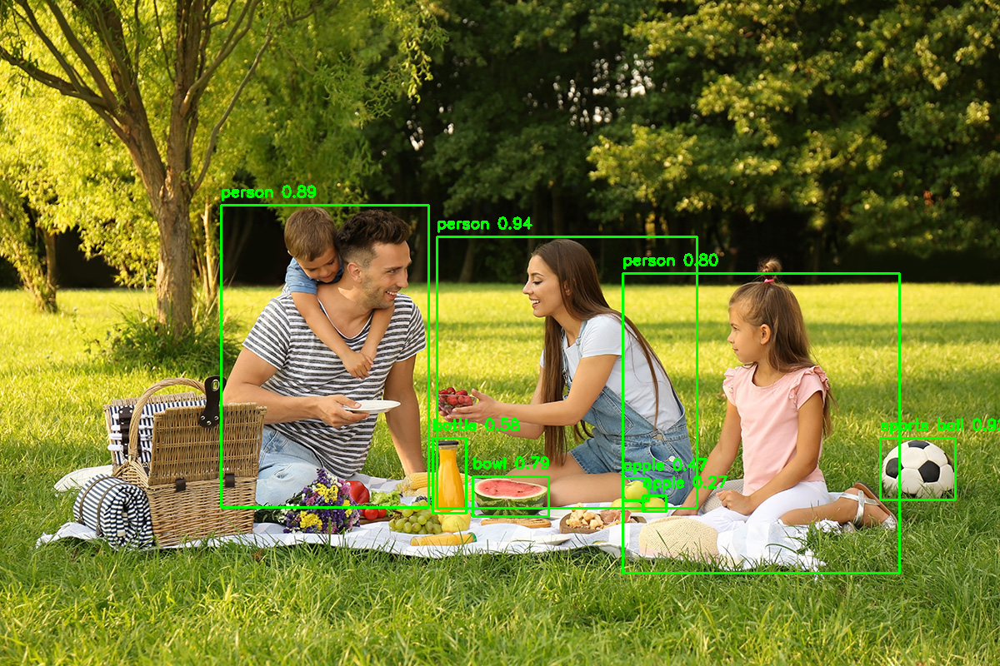

In [ ]:
import torch
from ultralytics import YOLO
from transformers import (
    AutoTokenizer,
    AutoModelForCausalLM,
    VisionEncoderDecoderModel,
    ViTImageProcessor
)
import cv2
import json
from collections import Counter, defaultdict
from google.colab.patches import cv2_imshow
from PIL import Image
import numpy as np

class ObjectDetection:
    def __init__(self, model_path):
        self.model = YOLO(model_path)

    def detect_objects(self, image_path):
        img = cv2.imread(image_path)
        results = self.model(img)
        detected_objects = []
        for result in results[0].boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = result
            label = self.model.names[int(cls)]
            detected_objects.append({
                "label": label,
                "confidence": round(conf, 2),
                "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
            })
        return img, detected_objects

    @staticmethod
    def annotate_image(img, detected_objects):
        annotated = img.copy()
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = f"{obj['label']} {obj['confidence']:.2f}"
            cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        return annotated

class ImageCaptioning:
    def __init__(self, model_name):
        self.model = VisionEncoderDecoderModel.from_pretrained(model_name)
        self.processor = ViTImageProcessor.from_pretrained(model_name)
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_caption(self, image):
        if isinstance(image, np.ndarray):
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = Image.fromarray(image)

        pixel_values = self.processor(image, return_tensors="pt").pixel_values

        with torch.no_grad():
            output_ids = self.model.generate(
                pixel_values,
                max_length=50,
                num_beams=4,
                early_stopping=True
            )

        caption = self.tokenizer.decode(output_ids[0], skip_special_tokens=True)
        return caption

class GPT2DescriptionGenerator:
    def __init__(self, model_name):
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.model = AutoModelForCausalLM.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_description(self, detected_objects, caption):
        if not detected_objects:
            return "No objects detected in the image."

        object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
        prompt = (
            f"Image caption: {caption}\n\n"
            f"Detected objects: {', '.join(object_list)}.\n\n"
            "Based on the caption and detected objects, provide a detailed description of the scene, "
            "including the spatial relationships between objects, their approximate locations, "
            "and any relevant context or activities taking place."
        )

        inputs = self.tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)
        outputs = self.model.generate(
            inputs.input_ids,
            attention_mask=inputs.attention_mask,
            max_new_tokens=150,
            num_beams=5,
            num_return_sequences=1,
            no_repeat_ngram_size=2,
            early_stopping=True,
            pad_token_id=self.tokenizer.eos_token_id
        )

        return self.tokenizer.decode(outputs[0], skip_special_tokens=True)

class UserGuidance:
    @staticmethod
    def generate_guidance(detected_objects, caption, image_width=640):
        if not detected_objects:
            return "I don't see anything in front of you."

        position_groups = defaultdict(list)
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = obj["label"]
            center_x = (x1 + x2) / 2
            if center_x < image_width / 3:
                position = "left"
            elif center_x > 2 * image_width / 3:
                position = "right"
            else:
                position = "front"
            position_groups[position].append(label)

        guidance = [f"General scene: {caption}"]
        for position, objects in position_groups.items():
            if objects:
                obj_counter = Counter(objects)
                descriptions = [f"{count} {obj}s" if count > 1 else f"a {obj}" for obj, count in obj_counter.items()]
                objects_text = ", ".join(descriptions[:-1]) + " and " + descriptions[-1] if len(descriptions) > 1 else descriptions[0]
                guidance.append(f"To your {position}, there is {objects_text}.")

        total_counter = Counter([obj["label"] for obj in detected_objects])
        if "person" in total_counter:
            guidance.append(f"In total, there {'is' if total_counter['person'] == 1 else 'are'} "
                           f"{total_counter['person']} {'person' if total_counter['person'] == 1 else 'people'} in the scene.")
        return " ".join(guidance)

class MainApp:
    def __init__(self, yolo_path, caption_model_name, gpt2_model_name):
        self.detector = ObjectDetection(yolo_path)
        self.captioner = ImageCaptioning(caption_model_name)
        self.description_generator = GPT2DescriptionGenerator(gpt2_model_name)
        self.guidance_generator = UserGuidance()

    def run(self, image_path):
        original_img, detected_objects = self.detector.detect_objects(image_path)
        image_caption = self.captioner.generate_caption(original_img)

        print("Image Caption:", image_caption)
        print("\nDetected Objects:", json.dumps(detected_objects, indent=2))

        description = self.description_generator.generate_description(detected_objects, image_caption)
        print("\nDetailed Description:", description)

        guidance = self.guidance_generator.generate_guidance(detected_objects, image_caption)
        print("\nUser Guidance:", guidance)

        annotated_img = self.detector.annotate_image(original_img.copy(), detected_objects)

        print("\nOriginal Image:")
        cv2_imshow(original_img)
        print("Annotated Image:")
        cv2_imshow(annotated_img)

# Example usage
if __name__ == "__main__":
    yolo_path = "yolov9c.pt"
    caption_model_name = "nlpconnect/vit-gpt2-image-captioning"
    gpt2_model_name = "gpt2"
    image_path = "/content/shutterstock_1501433546.jpg"

    app = MainApp(yolo_path, caption_model_name, gpt2_model_name)
    app.run(image_path)

In [ ]:
import torch
from ultralytics import YOLO
from transformers import (
    AutoTokenizer,
    AutoModelForCausalLM,
    VisionEncoderDecoderModel,
    ViTImageProcessor
)
import cv2
import json
from collections import Counter, defaultdict
from google.colab.patches import cv2_imshow
from PIL import Image
import numpy as np
from typing import List, Dict, Any

class ObjectDetection:
    def __init__(self, model_path):
        self.model = YOLO(model_path)

    def detect_objects(self, image_path):
        img = cv2.imread(image_path)
        results = self.model(img)
        detected_objects = []
        for result in results[0].boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = result
            label = self.model.names[int(cls)]
            detected_objects.append({
                "label": label,
                "confidence": round(conf, 2),
                "bounding_box": [int(x1), int(y1), int(x2), int(y2)]
            })
        return img, detected_objects

    @staticmethod
    def annotate_image(img, detected_objects):
        annotated = img.copy()
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = f"{obj['label']} {obj['confidence']:.2f}"
            cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated, label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
        return annotated

class ImageCaptioning:
    def __init__(self, model_name):
        self.model = VisionEncoderDecoderModel.from_pretrained(model_name)
        self.processor = ViTImageProcessor.from_pretrained(model_name)
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_caption(self, image):
        if isinstance(image, np.ndarray):
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image = Image.fromarray(image)

        pixel_values = self.processor(image, return_tensors="pt").pixel_values

        with torch.no_grad():
            output_ids = self.model.generate(
                pixel_values,
                max_length=50,
                num_beams=4,
                early_stopping=True
            )

        caption = self.tokenizer.decode(output_ids[0], skip_special_tokens=True)
        return caption

class GPT2DescriptionGenerator:
    def __init__(self, model_name):
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.model = AutoModelForCausalLM.from_pretrained(model_name)
        self.tokenizer.pad_token = self.tokenizer.eos_token

    def generate_description(self, detected_objects, caption):
        if not detected_objects:
            return "No objects detected in the image."

        object_list = [f"{obj['label']} with {obj['confidence'] * 100}% confidence" for obj in detected_objects]
        prompt = (
            f"Image caption: {caption}\n\n"
            f"Detected objects: {', '.join(object_list)}.\n\n"
            "Based on the caption and detected objects, provide a detailed description of the scene, "
            "including the spatial relationships between objects, their approximate locations, "
            "and any relevant context or activities taking place."
        )

        inputs = self.tokenizer(prompt, return_tensors="pt", padding=True, truncation=True)
        outputs = self.model.generate(
            inputs.input_ids,
            attention_mask=inputs.attention_mask,
            max_new_tokens=150,
            num_beams=5,
            num_return_sequences=1,
            no_repeat_ngram_size=2,
            early_stopping=True,
            pad_token_id=self.tokenizer.eos_token_id
        )

        return self.tokenizer.decode(outputs[0], skip_special_tokens=True)

class UserGuidance:
    @staticmethod
    def generate_guidance(detected_objects: List[Dict], caption: str, image_width: int = 640) -> Dict[str, List[str]]:
        if not detected_objects:
            return {"left": [], "front": [], "right": []}

        position_groups = defaultdict(list)
        for obj in detected_objects:
            x1, y1, x2, y2 = obj["bounding_box"]
            label = obj["label"]
            center_x = (x1 + x2) / 2
            if center_x < image_width / 3:
                position = "left"
            elif center_x > 2 * image_width / 3:
                position = "right"
            else:
                position = "front"
            position_groups[position].append(label)

        return dict(position_groups)

    @staticmethod
    def merge_guidance(all_guidance: List[Dict[str, List[str]]], captions: List[str]) -> str:
        # Merge all objects by position
        merged_positions = defaultdict(list)
        for guidance in all_guidance:
            for position, objects in guidance.items():
                merged_positions[position].extend(objects)

        # Create counter for each position
        position_counters = {
            pos: Counter(objects) for pos, objects in merged_positions.items()
        }

        # Generate comprehensive guidance
        guidance_parts = []

        # Add scene overview from all captions
        guidance_parts.append(f"Scene overview: {' '.join(captions)}")

        # Generate position-based guidance
        for position in ["left", "front", "right"]:
            if position in position_counters and position_counters[position]:
                counter = position_counters[position]
                descriptions = []
                for obj, count in counter.items():
                    if count > 1:
                        descriptions.append(f"{count} {obj}s")
                    else:
                        descriptions.append(f"a {obj}")

                if descriptions:
                    objects_text = ", ".join(descriptions[:-1]) + " and " + descriptions[-1] if len(descriptions) > 1 else descriptions[0]
                    guidance_parts.append(f"To your {position}, there is {objects_text}.")

        # Add total person count if applicable
        total_people = sum(counter["person"] for counter in position_counters.values() if "person" in counter)
        if total_people > 0:
            guidance_parts.append(
                f"In total, there {'is' if total_people == 1 else 'are'} "
                f"{total_people} {'person' if total_people == 1 else 'people'} in the scene."
            )

        return " ".join(guidance_parts)

class MainApp:
    def __init__(self, yolo_path, caption_model_name, gpt2_model_name):
        self.detector = ObjectDetection(yolo_path)
        self.captioner = ImageCaptioning(caption_model_name)
        self.description_generator = GPT2DescriptionGenerator(gpt2_model_name)
        self.guidance_generator = UserGuidance()

    def process_single_image(self, image_path):
        original_img, detected_objects = self.detector.detect_objects(image_path)
        image_caption = self.captioner.generate_caption(original_img)
        description = self.description_generator.generate_description(detected_objects, image_caption)
        guidance = self.guidance_generator.generate_guidance(detected_objects, image_caption)
        annotated_img = self.detector.annotate_image(original_img.copy(), detected_objects)

        return {
            "original_img": original_img,
            "annotated_img": annotated_img,
            "caption": image_caption,
            "detected_objects": detected_objects,
            "description": description,
            "guidance": guidance
        }

    def run(self, image_paths: List[str]):
        results = []
        all_guidance = []
        all_captions = []

        # Process each image
        for image_path in image_paths:
            result = self.process_single_image(image_path)
            results.append(result)
            all_guidance.append(result["guidance"])
            all_captions.append(result["caption"])

        # Generate merged guidance
        merged_guidance = self.guidance_generator.merge_guidance(all_guidance, all_captions)

        # Print results for each image
        for i, result in enumerate(results, 1):
            print(f"\nImage {i} Caption:", result["caption"])
            print(f"\nImage {i} Detected Objects:", json.dumps(result["detected_objects"], indent=2))
            print(f"\nImage {i} Detailed Description:", result["description"])

            print(f"\nOriginal Image {i}:")
            cv2_imshow(result["original_img"])
            print(f"Annotated Image {i}:")
            cv2_imshow(result["annotated_img"])

        # Print merged guidance
        print("\nMerged Scene Guidance:", merged_guidance)

# Example usage
if __name__ == "__main__":
    yolo_path = "yolov9c.pt"
    caption_model_name = "nlpconnect/vit-gpt2-image-captioning"
    gpt2_model_name = "gpt2"
    image_paths = [
        "/content/pexels-joshsorenson-139303 (1).jpg",
        "/content/shutterstock_1501433546.jpg"
    ]

    app = MainApp(yolo_path, caption_model_name, gpt2_model_name)
    app.run(image_paths)

In [ ]:
import torch
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
import requests

# Load the pre-trained BLIP model and processor
processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

# Function to generate captions for an image
def generate_caption(image_path):
    # Load the image
    if image_path.startswith('http'):
        image = Image.open(requests.get(image_path, stream=True).raw)
    else:
        image = Image.open(image_path)

    # Preprocess the image
    inputs = processor(images=image, return_tensors="pt")

    # Generate the caption
    with torch.no_grad():
        output = model.generate(**inputs)

    # Decode the generated caption
    caption = processor.decode(output[0], skip_special_tokens=True)
    return caption

# Example usage
image_path = "/content/images.jpg"  # Replace with your image URL or local path
caption = generate_caption(image_path)
print("Generated Caption:", caption)


In [ ]:
pip install torch torchvision transformers Pillow


In [ ]:
import torch
from torchvision import transforms
from transformers import VisionEncoderDecoderModel, ViTImageProcessor, AutoTokenizer, GPT2LMHeadModel, GPT2Tokenizer
from PIL import Image
import requests

# Load the pre-trained Vision Transformer (ViT) model and tokenizer
model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

# Load the GPT-2 model and tokenizer
gpt2_model = GPT2LMHeadModel.from_pretrained("gpt2")
gpt2_tokenizer = GPT2Tokenizer.from_pretrained("gpt2")

# Function to generate detailed descriptions for an image
def generate_detailed_description(image_path):
    # Load the image
    if image_path.startswith('http'):
        image = Image.open(requests.get(image_path, stream=True).raw)
    else:
        image = Image.open(image_path)

    # Preprocess the image
    inputs = image_processor(images=image, return_tensors="pt")

    # Generate the description
    with torch.no_grad():
        output = model.generate(**inputs)

    # Decode the generated description
    description = tokenizer.decode(output[0], skip_special_tokens=True)
    return description

# Function to refine the description using GPT-2
def refine_description_with_gpt2(description):
    prompt = f"Enhance this description: '{description}'"
    input_ids = gpt2_tokenizer.encode(prompt, return_tensors='pt')

    # Generate a refined description
    with torch.no_grad():
        output = gpt2_model.generate(input_ids, max_length=50, num_return_sequences=1)

    refined_description = gpt2_tokenizer.decode(output[0], skip_special_tokens=True)
    return refined_description.replace(prompt, '').strip()  # Clean the output

# Example usage
image_path = "/content/shutterstock_1501433546.jpg"  # Replace with your image URL or local path
description = generate_detailed_description(image_path)
print("Generated Description:", description)

refined_description = refine_description_with_gpt2(description)
print("Refined Description:", refined_description)


Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "qkv_bias": true,
  "transformers_version": "4.46.2"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_token_id": 50256,
  "embd_pdrop": 0.1,
  "eos_token_id": 50256,
  "initializer_rang

Generated Description: a woman and two children sit on a park bench 
Refined Description: 'A woman and two children sit on a park bench '

'A woman and two children sit on a park bench '

'A woman


In [ ]:
!pip install openai-whisper
!pip install torch


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 800.5/800.5 kB 12.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.5/209.5 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 45.6 MB/s eta 0:00:00
  Created wheel for openai-whisper: filename=openai_whisper-20240930-py3-none-any.whl size=803321 sha256=8c3c5cb1274b2d4dd094aa04b0dd0504f7384a22008cc8a84fdf64cc16d8544b
  Stored in directory: /root/.cache/pip/wheels/dd/4a/1f/d1c4bf3b9133c8168fe617ed979cab7b14fe381d059ffb9d83
Successfully built openai-whisper


In [ ]:
import whisper

# Load the Whisper model
model = whisper.load_model("small")  # "small" is a good balance between speed and accuracy

# Transcribe the audio
result = model.transcribe("/content/QA-01.mp3")

# Print the transcription
print("Transcription:", result["text"])


100%|███████████████████████████████████████| 461M/461M [00:12<00:00, 39.8MiB/s]
/usr/local/lib/python3.10/dist-packages/whisper/transcribe.py:126: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")


Transcription:  How many people are there in your family? There are five people in my family. My father, mother, brother, sister, and me. Does your family live in a house or an apartment? We live in a house in the countryside. What does your father do? My father is a doctor. He works at the local hospital. How old is your mother? She is 40 years old, one year younger than my father. Do you have any siblings? What's his or her name? Yes, I do. I have one elder brother, David, and one younger sister, Mary. Are you the oldest among your brothers and sisters? No, I'm not. I'm the second child in my family. What does your mother, father, like? My father likes playing football and my mother likes cooking. Do your parents let you stay out late? Of course not. They always ask me to get home before 10pm each night. Do you stay with your parents? Right now, no, but I used to. Does your family usually have dinner together? Yes, we do. My mom always prepares delicious meals for us.


In [ ]:
import whisper
import pickle

# Load the Whisper model
model = whisper.load_model("small")  # "small" is a good balance between speed and accuracy


# Export the transcription result to a pickle file
with open("/content/transcription_result.pkl", "wb") as f:
    pickle.dump(result, f)

print("Transcription saved in 'transcription_result.pkl'")


Transcription saved in 'transcription_result.pkl'


In [ ]:
pip install faster_whisper

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 34.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.1/33.1 MB 34.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.4/38.4 MB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 77.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.4 MB/s eta 0:00:00


In [ ]:
from faster_whisper import WhisperModel

model = WhisperModel("tiny.en")

segments, info = model.transcribe("/content/QA-01 (1).mp3")

print(info)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer.json:   0%|          | 0.00/2.13M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/2.32k [00:00<?, ?B/s]

model.bin:   0%|          | 0.00/75.5M [00:00<?, ?B/s]

vocabulary.txt:   0%|          | 0.00/422k [00:00<?, ?B/s]

TranscriptionInfo(language='en', language_probability=1, duration=76.0918125, duration_after_vad=76.0918125, all_language_probs=None, transcription_options=TranscriptionOptions(beam_size=5, best_of=5, patience=1, length_penalty=1, repetition_penalty=1, no_repeat_ngram_size=0, log_prob_threshold=-1.0, no_speech_threshold=0.6, compression_ratio_threshold=2.4, condition_on_previous_text=True, prompt_reset_on_temperature=0.5, temperatures=[0.0, 0.2, 0.4, 0.6, 0.8, 1.0], initial_prompt=None, prefix=None, suppress_blank=True, suppress_tokens=(1, 2, 7, 8, 9, 10, 14, 25, 26, 27, 28, 29, 31, 58, 59, 60, 61, 62, 63, 90, 91, 92, 93, 357, 366, 438, 532, 685, 705, 796, 930, 1058, 1220, 1267, 1279, 1303, 1343, 1377, 1391, 1635, 1782, 1875, 2162, 2361, 2488, 3467, 4008, 4211, 4600, 4808, 5299, 5855, 6329, 7203, 9609, 9959, 10563, 10786, 11420, 11709, 11907, 13163, 13697, 13700, 14808, 15306, 16410, 16791, 17992, 19203, 19510, 20724, 22305, 22935, 27007, 30109, 30420, 33409, 34949, 40283, 40493, 40549

In [ ]:
for segment in segments:
    print(f"[{segment.start:.2f} - {segment.end:.2f}]: {segment.text}")

[0.00 - 2.56]:  How many people are there in your family?
[2.56 - 4.88]:  There are five people in my family.
[4.88 - 10.56]:  My father, mother, brother, sister, and me.
[10.56 - 14.00]:  Does your family live in a house or an apartment?
[14.00 - 17.28]:  We live in a house in the countryside.
[17.28 - 19.60]:  What does your father do?
[19.60 - 21.60]:  My father is a doctor.
[21.60 - 24.24]:  He works at the local hospital.
[24.24 - 26.24]:  How old is your mother?
[26.24 - 28.08]:  She is 40 years old.
[28.08 - 30.72]:  One year younger than my father.
[30.72 - 32.72]:  Do you have any siblings?
[32.72 - 34.96]:  What's his or her name?
[34.96 - 36.48]:  Yes, I do.
[36.48 - 42.00]:  I have one elder brother, David, and one younger sister, Mary.
[42.00 - 44.72]:  Are you the oldest among your brothers and sisters?
[44.72 - 46.16]:  No, I'm not.
[46.16 - 48.80]:  I'm the second child in my family.
[48.80 - 51.28]:  What is your mother or father like?
[51.28 - 55.36]:  My father likes

In [ ]:
# Assuming `segments` is a list of objects with `start`, `end`, and `text` attributes
merged_text = " ".join(segment.text.strip() for segment in segments)

# Print the combined text
print(merged_text)


In [ ]:
full_text = ""
for segment in segments:
    full_text += f"[{segment.start:.2f} - {segment.end:.2f}]: {segment.text}\n"


In [ ]:
full_text = "\n".join(f"[{segment.start:.2f} - {segment.end:.2f}]: {segment.text}" for segment in segments)


In [ ]:
segment

Segment(id=30, seek=5536, start=72.88, end=75.84, text=' My mom always prepares delicious meals for us.', tokens=[51239, 2011, 1995, 1464, 25978, 12625, 13840, 329, 514, 13, 51387], avg_logprob=-0.15214215637592787, compression_ratio=1.4404145077720207, no_speech_prob=0.1511702686548233, words=None, temperature=0.0)